In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from tqdm import tqdm
from config.path import STORAGE, VERVET_DATA
from transmittance2fom_genmodels.notebooks.dataloaderEX4 import create_paired_dataloader
import os
from transmittance2fom_genmodels.notebooks.image2image_model_EX4 import Generator, Discriminator

def train_pix2pix(train_loader: DataLoader, val_loader: DataLoader = None, 
                  num_epochs: int = 100, device: str = 'cuda'):
    
    # Initialize models
    generator = Generator().to(device)
    discriminator = Discriminator().to(device)
    
    # Loss functions
    criterion_gan = nn.BCEWithLogitsLoss()
    criterion_l1 = nn.L1Loss()
    
    # Optimizers
    optimizer_g = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    optimizer_d = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    
    # Training loop
    for epoch in range(num_epochs):
        generator.train()
        discriminator.train()
        
        pbar = tqdm(train_loader, desc=f'Epoch {epoch+1}/{num_epochs}')
        for batch in pbar:
            real_input = batch['input'].to(device)
            real_target = batch['target'].to(device)
            
            # Train Discriminator
            optimizer_d.zero_grad()
            
            fake_output = generator(real_input)
            fake_disc_input = torch.cat([real_input, fake_output], 1)
            fake_disc_output = discriminator(real_input, fake_output.detach())
            
            real_disc_input = torch.cat([real_input, real_target], 1)
            real_disc_output = discriminator(real_input, real_target)
            
            d_loss_real = criterion_gan(real_disc_output, 
                                      torch.ones_like(real_disc_output))
            d_loss_fake = criterion_gan(fake_disc_output, 
                                      torch.zeros_like(fake_disc_output))
            d_loss = (d_loss_real + d_loss_fake) * 0.5
            
            d_loss.backward()
            optimizer_d.step()
            
            # Train Generator
            optimizer_g.zero_grad()
            
            fake_output = generator(real_input)
            fake_disc_output = discriminator(real_input, fake_output)
            
            g_loss_gan = criterion_gan(fake_disc_output, torch.ones_like(fake_disc_output))
            g_loss_l1 = criterion_l1(fake_output, real_target) * 100
            g_loss = g_loss_gan + g_loss_l1
            
            g_loss.backward()
            optimizer_g.step()
            
            pbar.set_postfix({
                'D_loss': f'{d_loss.item():.4f}',
                'G_loss': f'{g_loss.item():.4f}'
            })
            
        # Save checkpoint
        if (epoch + 1) % 10 == 0:
            torch.save({
                'epoch': epoch,
                'generator_state_dict': generator.state_dict(),
                'discriminator_state_dict': discriminator.state_dict(),
                'optimizer_g_state_dict': optimizer_g.state_dict(),
                'optimizer_d_state_dict': optimizer_d.state_dict(),
            }, f'pix2pix_checkpoint_epoch_{epoch+1}.pth')
            
    return generator, discriminator

if __name__ == "__main__":
    # Create dataloaders
    data_dir = VERVET_DATA
    
    print(data_dir)
    train_loader = create_paired_dataloader(
        data_dir=data_dir,
        brain="Vervet1818",
        patch_size=256,
        batch_size=32,
        tiles_per_epoch=500
    )
    
        
    val_loader = create_paired_dataloader(
            data_dir=data_dir,
            brain="Vervet1947",
            patch_size=256,
            batch_size=8,
            tiles_per_epoch=100
        )

device = torch.device("cuda" if torch.cuda.is_available() else "mps:0")
# Train the model
generator, _ = train_pix2pix(train_loader, val_loader, num_epochs=20, device=device)
torch.save(generator.state_dict(), STORAGE / "image2image" / "generator.pth")



/Users/hanneswidera/Uni/Master/Semester 3/Generative Models/exercises/Project 2/Transmittance2FOM-GenModels/data


Epoch 20/20: 100%|██████████| 16/16 [00:23<00:00,  1.45s/it, D_loss=0.0060, G_loss=11.7368]


# Generate Images from Various Patches

/var/folders/4g/91bm8hl51ld9v8c8tg6_lrqw0000gn/T/ipykernel_76206/739863650.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(STORAGE /

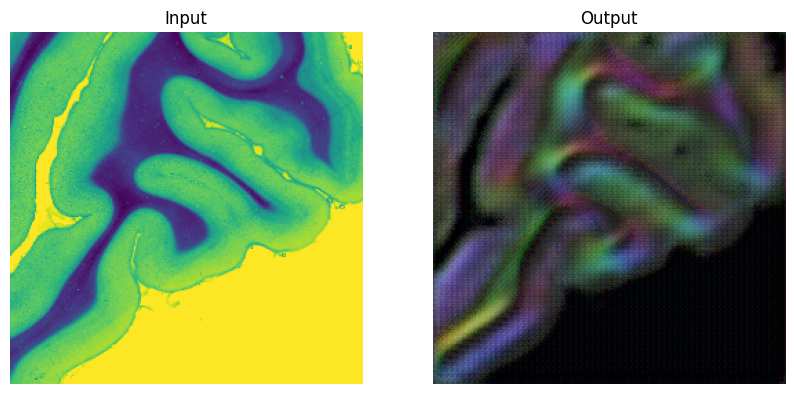

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.2725906..0.7805986].


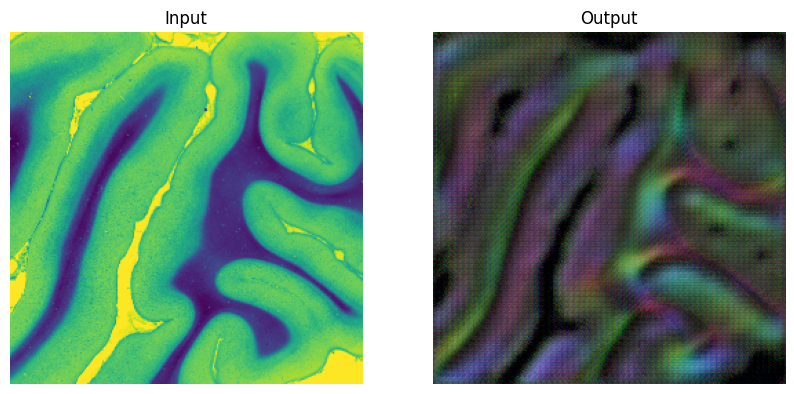

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.33701742..0.76817256].


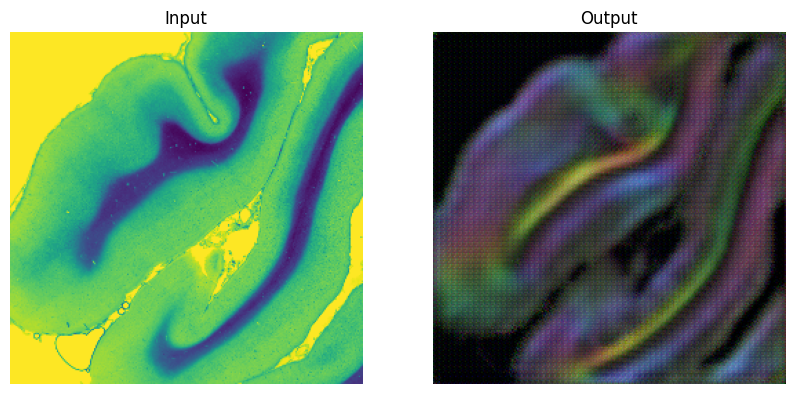

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.31773713..0.8046689].


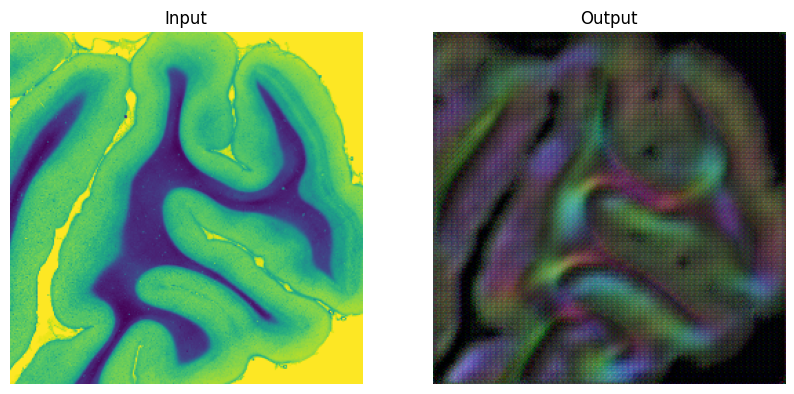

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.26983893..0.7743826].


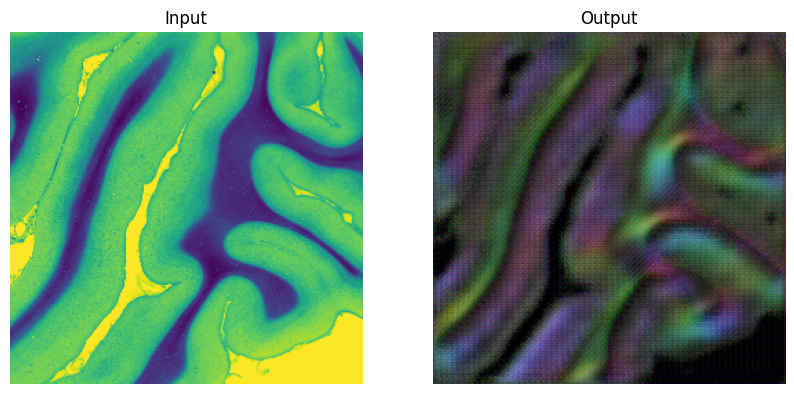

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.31880775..0.7932816].


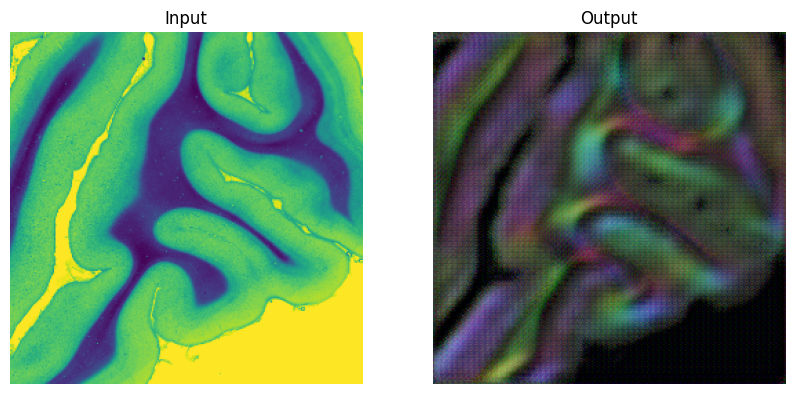

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.26917526..0.8025318].


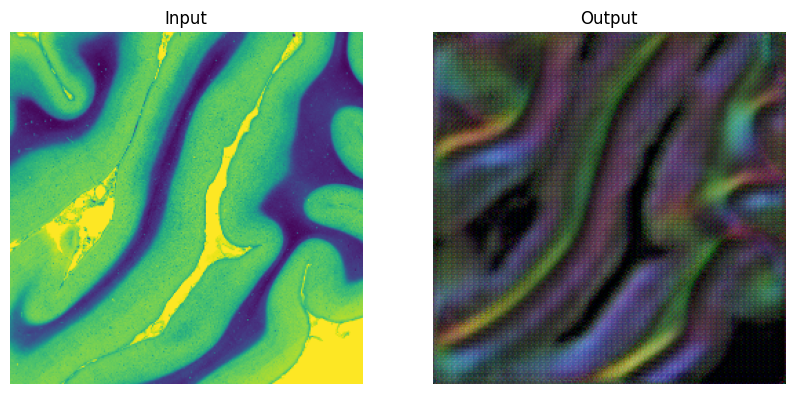

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.2705914..0.80963147].


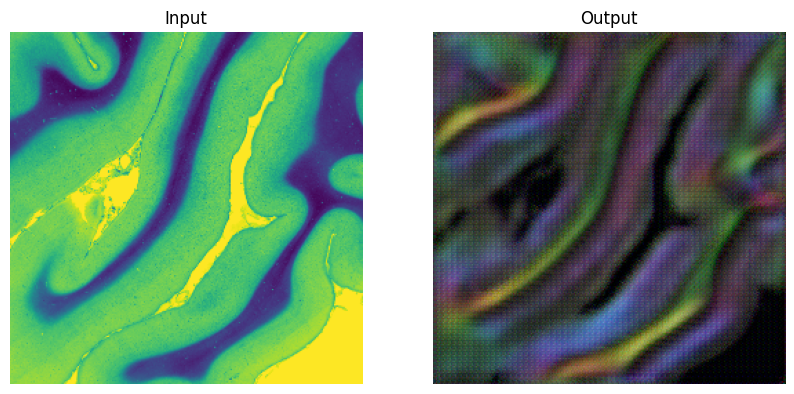

In [5]:
import matplotlib.pyplot as plt
# Load the model
generator = Generator().to(device)
generator.load_state_dict(torch.load(STORAGE / "image2image" / "generator.pth"))


# Generate images
generator.eval()
with torch.no_grad():
    for batch in val_loader:
        real_input = batch['input'].to(device)
        fake_output = generator(real_input)
        # Display the images
        for i in range(real_input.size(0)):
            real_input_img = real_input[i].permute(1, 2, 0).cpu().numpy()
            fake_output_img = fake_output[i].permute(1, 2, 0).cpu().numpy()
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            plt.imshow(real_input_img)
            plt.title('Input')
            plt.axis('off')
            plt.subplot(1, 2, 2)
            plt.imshow(fake_output_img)
            plt.title('Output')
            plt.axis('off')
            plt.show()
        break
    

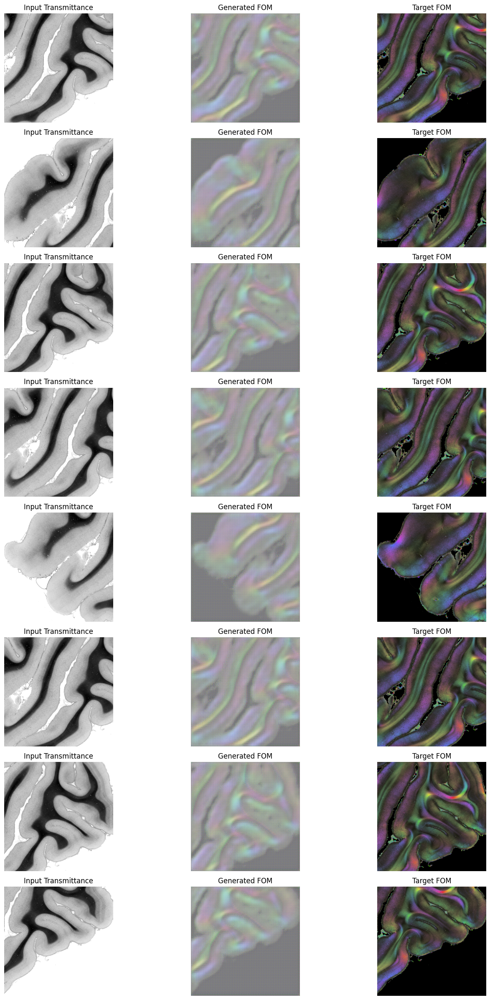

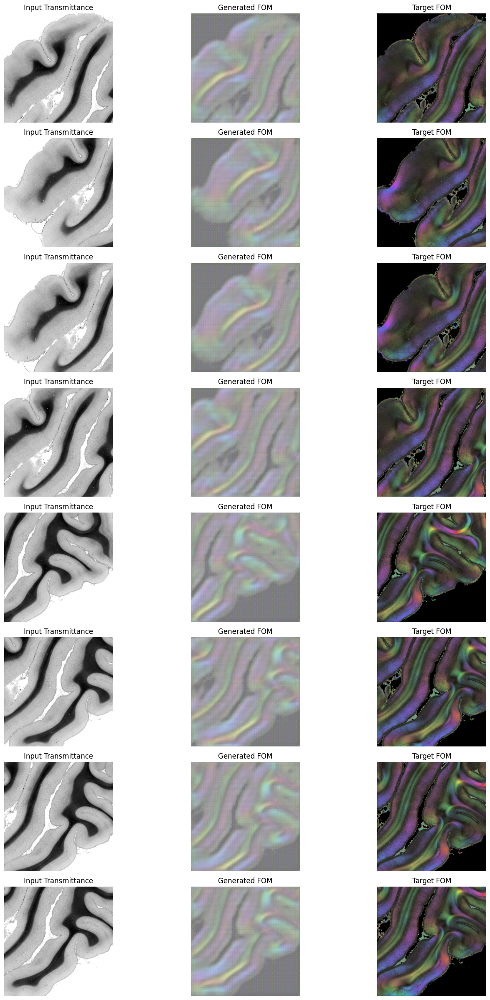

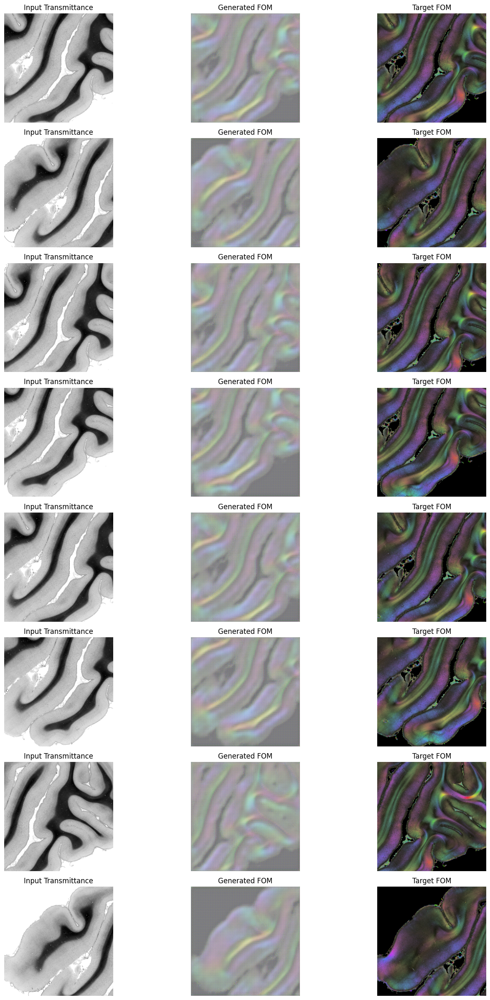

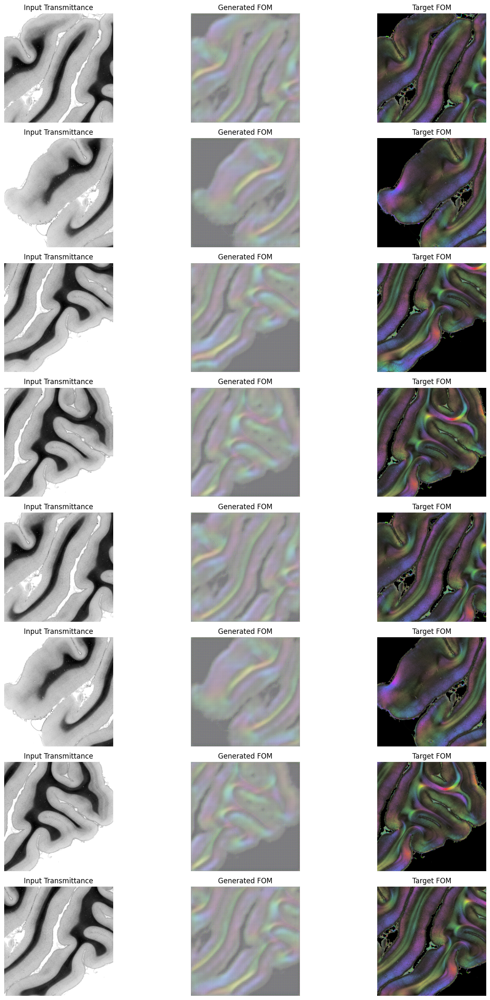

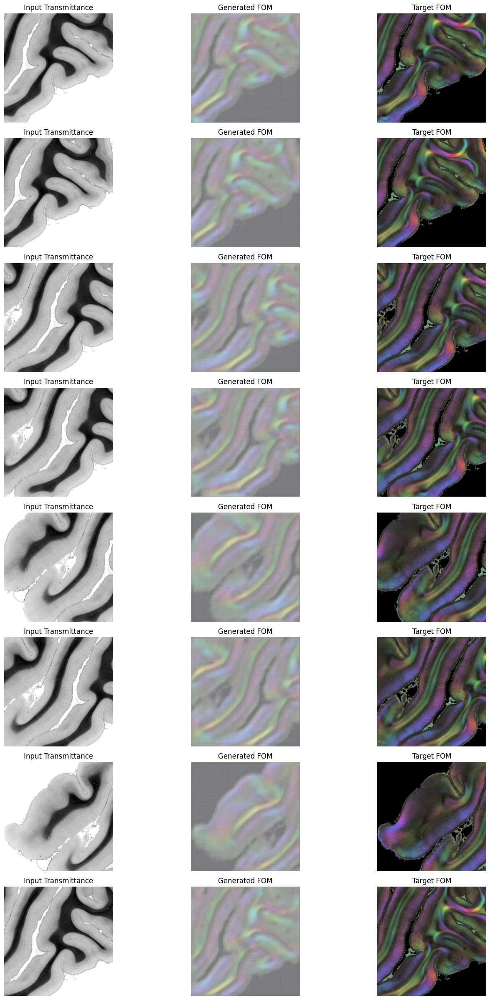

In [6]:
import numpy as np
def generate_and_visualize_foms(generator, test_loader, device, num_samples=5):
    """Generate FOMs and visualize them alongside inputs and targets."""
    with torch.no_grad():
        for batch_idx, batch in enumerate(test_loader):
            if batch_idx >= num_samples:
                break
                
            # Get input and target
            input_trans = batch['input'].to(device)
            target_fom = batch['target']
            
            # Generate FOM
            generated_fom = generator(input_trans)
            
            # Move tensors to CPU and convert to numpy for visualization
            input_trans = input_trans.cpu()
            generated_fom = generated_fom.cpu()
            
            # Plot results
            fig, axes = plt.subplots(input_trans.size(0), 3, figsize=(15, 3*input_trans.size(0)))
            
            for i in range(input_trans.size(0)):
                # Plot transmittance input
                axes[i, 0].imshow(input_trans[i, 0].numpy(), cmap='gray')
                axes[i, 0].set_title('Input Transmittance')
                axes[i, 0].axis('off')
                
                # Plot generated FOM
                gen_fom = generated_fom[i].permute(1, 2, 0).numpy()
                gen_fom = (gen_fom + 1) / 2.0  # Convert from [-1, 1] to [0, 1]
                gen_fom = np.clip(gen_fom, 0, 1)
                axes[i, 1].imshow(gen_fom)
                axes[i, 1].set_title('Generated FOM')
                axes[i, 1].axis('off')
                
                # Plot target FOM
                target = target_fom[i].permute(1, 2, 0).numpy()
                axes[i, 2].imshow(target)
                axes[i, 2].set_title('Target FOM')
                axes[i, 2].axis('off')
            
            plt.tight_layout()
            plt.show()
            
generate_and_visualize_foms(generator, val_loader, device, num_samples=5)